In [1]:
# set up path to facenet_pytorch_c
import sys
sys.path.insert(1, '/home/ubuntu/mtcnn')

# facenet_pytorch_c: avoid confusion with system default facenet_pytorch
from facenet_pytorch_c import MTCNN


from tqdm import tqdm
import numpy as np
import os

# Built-in
import os
from glob import glob

# Libs
from skimage import io, color
import skimage.transform as sktrsfm
from sklearn.metrics import precision_score, recall_score

# Pytorch
import torch
import torch.nn.functional as F
from torch.utils import data

import torchvision
from torchvision import transforms


In [2]:
parent_path = '/home/ubuntu/db_proc/db/images'

In [38]:
img_files = sorted(glob(os.path.join(parent_path, '[!n]*.jpg')))
imgs = [io.imread(a) for a in img_files]

In [39]:
# setup mtcnn

device = "cuda:0"

mtcnn = MTCNN(
    image_size=160, margin=0, min_face_size=20,
    thresholds=[0.6, 0.7, 0.7], factor=0.709, post_process=True, keep_all=True,
    device=device
)

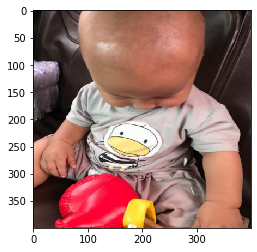

/home/ubuntu/db_proc/db/images/0_16.jpg


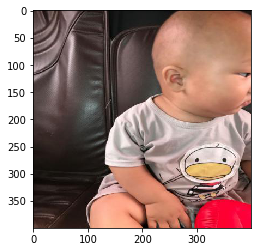

/home/ubuntu/db_proc/db/images/0_31.jpg


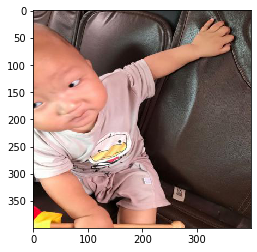

/home/ubuntu/db_proc/db/images/0_34.jpg


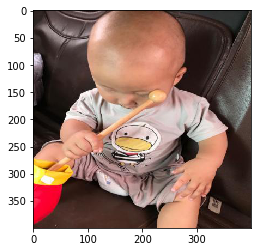

/home/ubuntu/db_proc/db/images/0_35.jpg


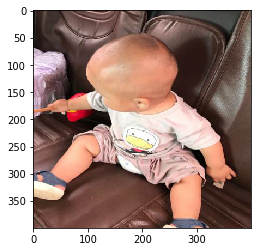

/home/ubuntu/db_proc/db/images/0_45.jpg


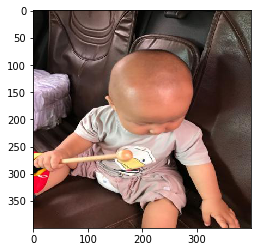

/home/ubuntu/db_proc/db/images/0_50.jpg


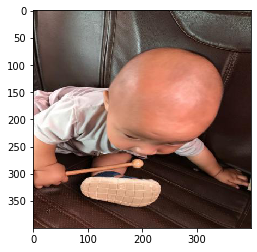

/home/ubuntu/db_proc/db/images/0_51.jpg


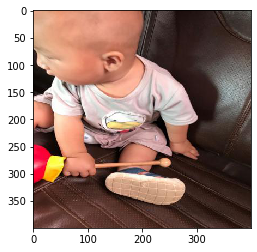

/home/ubuntu/db_proc/db/images/0_52.jpg


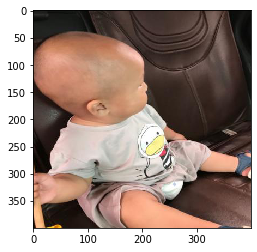

/home/ubuntu/db_proc/db/images/0_57.jpg


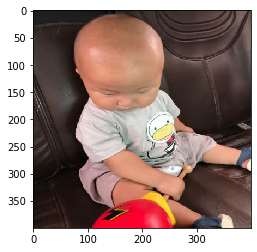

/home/ubuntu/db_proc/db/images/0_59.jpg


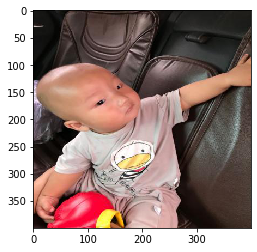

/home/ubuntu/db_proc/db/images/0_7.jpg


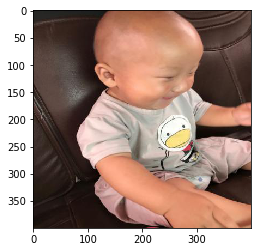

/home/ubuntu/db_proc/db/images/0_73.jpg


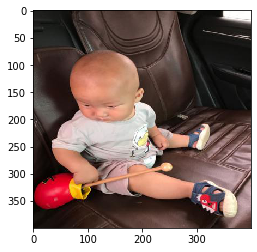

/home/ubuntu/db_proc/db/images/0_79.jpg


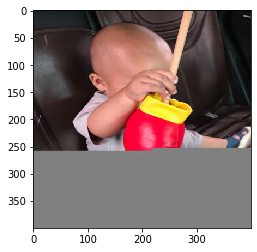

/home/ubuntu/db_proc/db/images/0_85.jpg


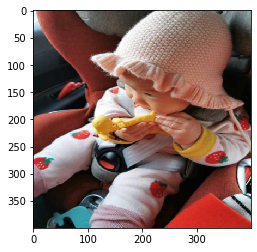

/home/ubuntu/db_proc/db/images/1_10.jpg


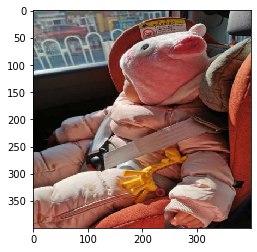

/home/ubuntu/db_proc/db/images/1_17.jpg


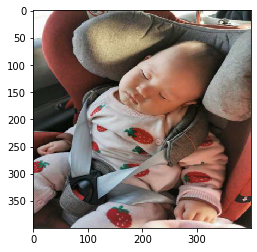

/home/ubuntu/db_proc/db/images/1_18.jpg


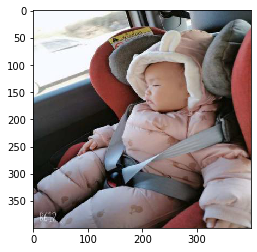

/home/ubuntu/db_proc/db/images/1_9.jpg


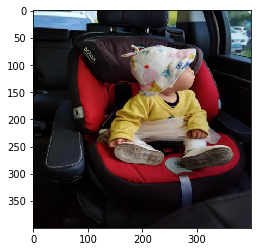

/home/ubuntu/db_proc/db/images/2_0.jpg


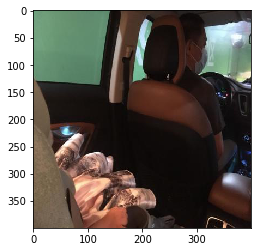

/home/ubuntu/db_proc/db/images/2_138.jpg


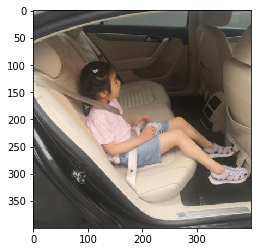

/home/ubuntu/db_proc/db/images/2_232.jpg


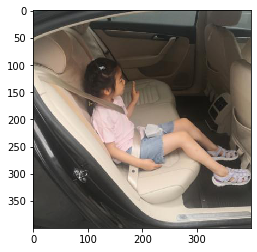

/home/ubuntu/db_proc/db/images/2_233.jpg


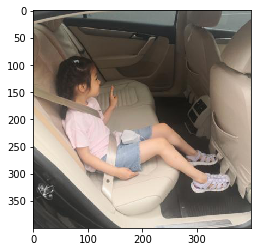

/home/ubuntu/db_proc/db/images/2_234.jpg


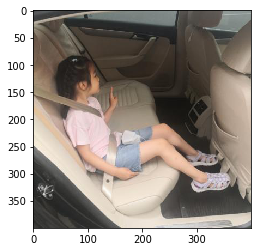

/home/ubuntu/db_proc/db/images/2_235.jpg


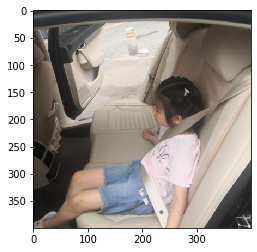

/home/ubuntu/db_proc/db/images/2_252.jpg


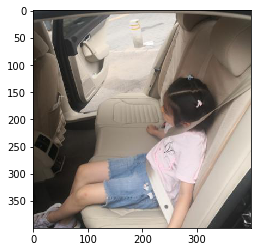

/home/ubuntu/db_proc/db/images/2_255.jpg


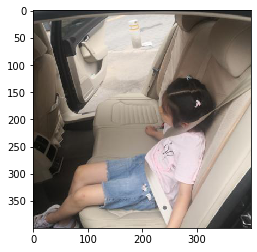

/home/ubuntu/db_proc/db/images/2_256.jpg


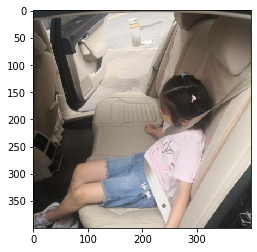

/home/ubuntu/db_proc/db/images/2_257.jpg


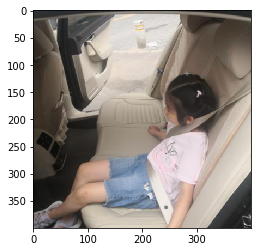

/home/ubuntu/db_proc/db/images/2_258.jpg


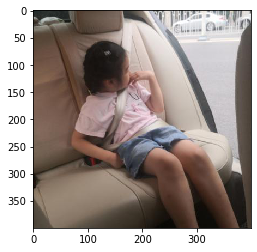

/home/ubuntu/db_proc/db/images/2_273.jpg


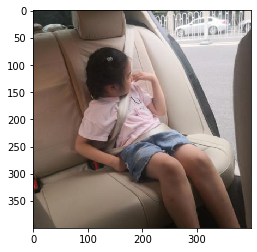

/home/ubuntu/db_proc/db/images/2_274.jpg


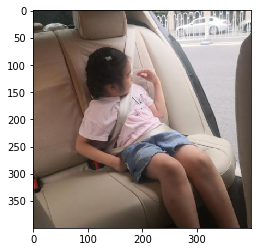

/home/ubuntu/db_proc/db/images/2_275.jpg


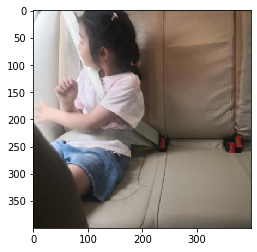

/home/ubuntu/db_proc/db/images/2_284.jpg


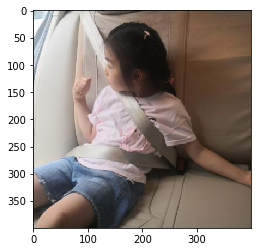

/home/ubuntu/db_proc/db/images/2_286.jpg


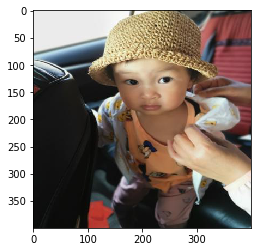

/home/ubuntu/db_proc/db/images/2_29.jpg


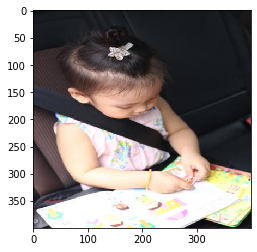

/home/ubuntu/db_proc/db/images/2_381.jpg


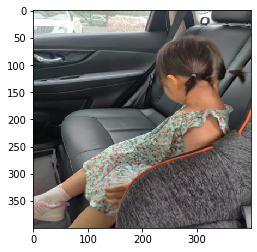

/home/ubuntu/db_proc/db/images/2_437.jpg


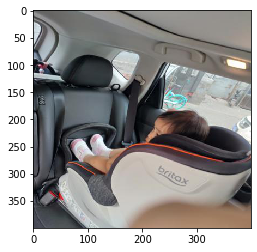

/home/ubuntu/db_proc/db/images/2_455.jpg


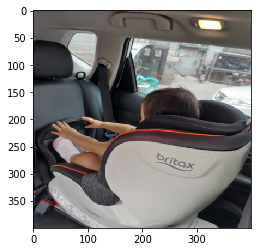

/home/ubuntu/db_proc/db/images/2_456.jpg


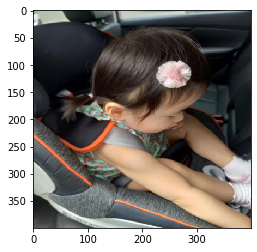

/home/ubuntu/db_proc/db/images/2_467.jpg


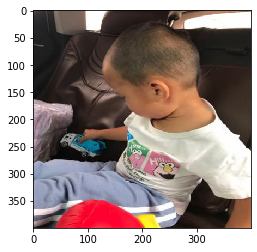

/home/ubuntu/db_proc/db/images/2_53.jpg


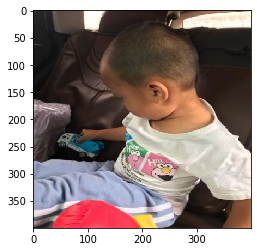

/home/ubuntu/db_proc/db/images/2_54.jpg


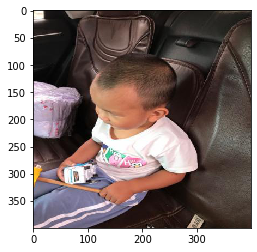

/home/ubuntu/db_proc/db/images/2_99.jpg


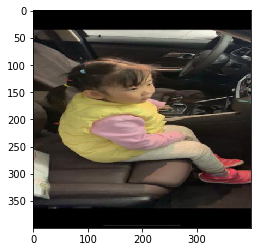

/home/ubuntu/db_proc/db/images/3_0.jpg


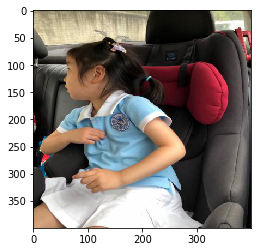

/home/ubuntu/db_proc/db/images/3_108.jpg


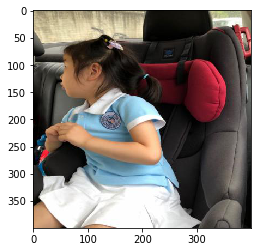

/home/ubuntu/db_proc/db/images/3_110.jpg


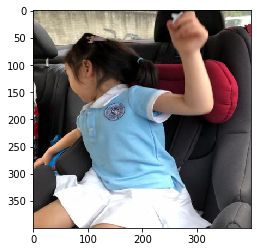

/home/ubuntu/db_proc/db/images/3_112.jpg


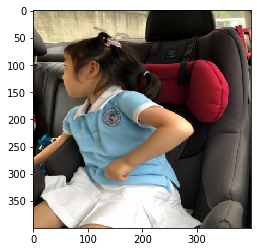

/home/ubuntu/db_proc/db/images/3_114.jpg


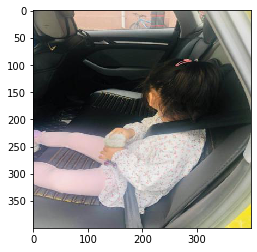

/home/ubuntu/db_proc/db/images/3_12.jpg


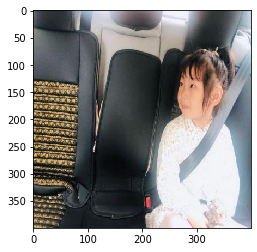

/home/ubuntu/db_proc/db/images/3_14.jpg


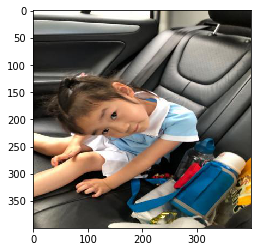

/home/ubuntu/db_proc/db/images/3_143.jpg


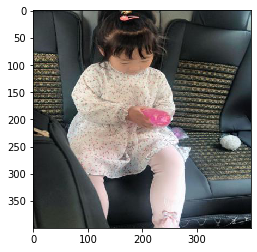

/home/ubuntu/db_proc/db/images/3_16.jpg


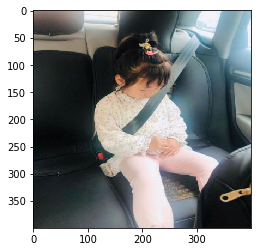

/home/ubuntu/db_proc/db/images/3_19.jpg


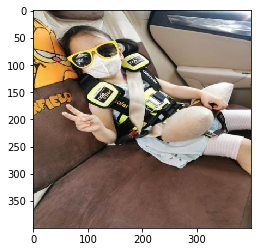

/home/ubuntu/db_proc/db/images/3_20.jpg


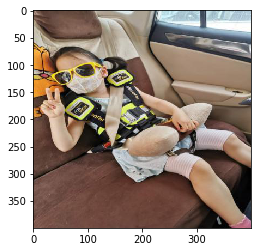

/home/ubuntu/db_proc/db/images/3_21.jpg


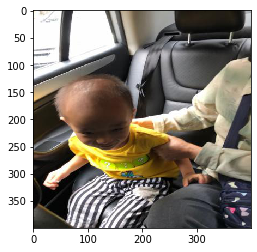

/home/ubuntu/db_proc/db/images/3_283.jpg


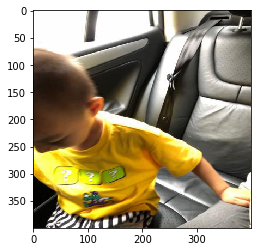

/home/ubuntu/db_proc/db/images/3_305.jpg


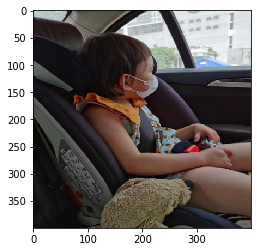

/home/ubuntu/db_proc/db/images/3_31.jpg


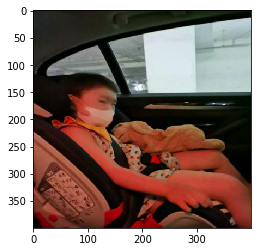

/home/ubuntu/db_proc/db/images/3_32.jpg


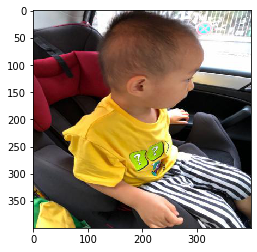

/home/ubuntu/db_proc/db/images/3_329.jpg


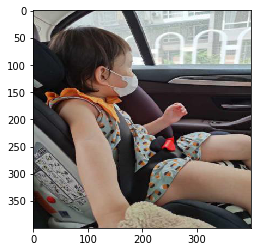

/home/ubuntu/db_proc/db/images/3_34.jpg


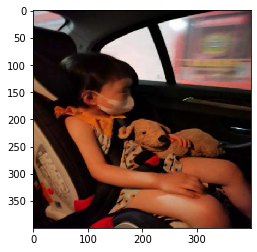

/home/ubuntu/db_proc/db/images/3_35.jpg


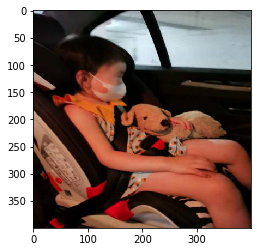

/home/ubuntu/db_proc/db/images/3_36.jpg


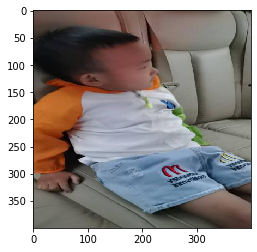

/home/ubuntu/db_proc/db/images/3_360.jpg


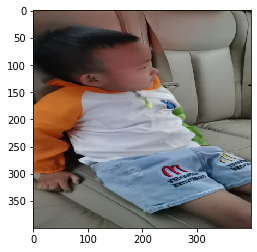

/home/ubuntu/db_proc/db/images/3_364.jpg


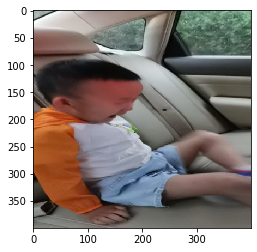

/home/ubuntu/db_proc/db/images/3_365.jpg


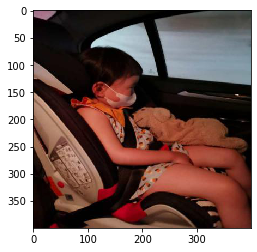

/home/ubuntu/db_proc/db/images/3_37.jpg


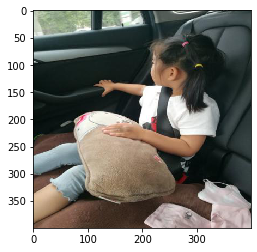

/home/ubuntu/db_proc/db/images/3_376.jpg


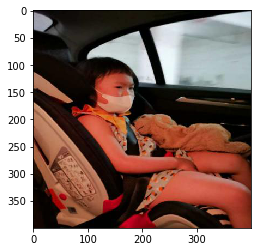

/home/ubuntu/db_proc/db/images/3_38.jpg


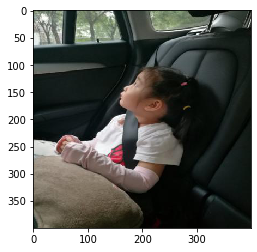

/home/ubuntu/db_proc/db/images/3_382.jpg


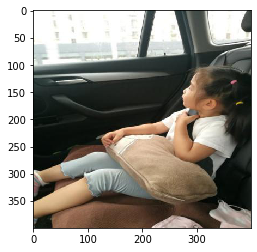

/home/ubuntu/db_proc/db/images/3_385.jpg


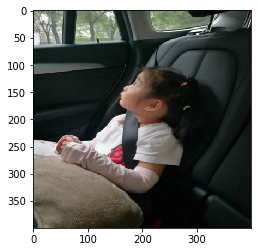

/home/ubuntu/db_proc/db/images/3_386.jpg


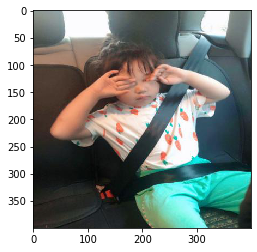

/home/ubuntu/db_proc/db/images/3_390.jpg


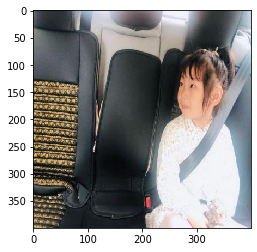

/home/ubuntu/db_proc/db/images/3_400.jpg


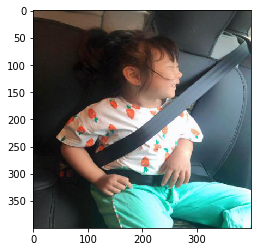

/home/ubuntu/db_proc/db/images/3_402.jpg


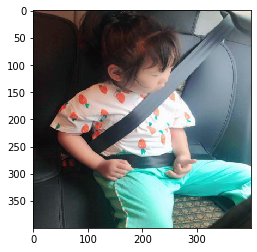

/home/ubuntu/db_proc/db/images/3_406.jpg


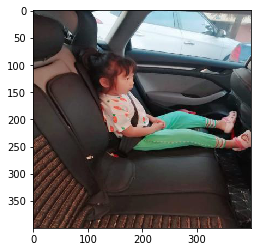

/home/ubuntu/db_proc/db/images/3_410.jpg


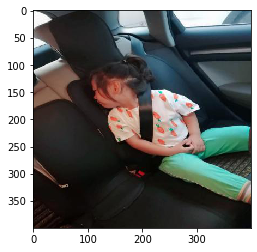

/home/ubuntu/db_proc/db/images/3_412.jpg


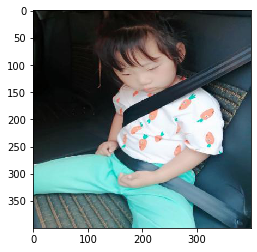

/home/ubuntu/db_proc/db/images/3_415.jpg


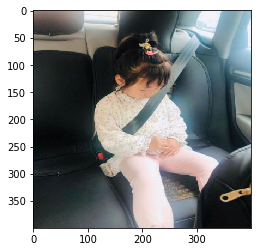

/home/ubuntu/db_proc/db/images/3_422.jpg


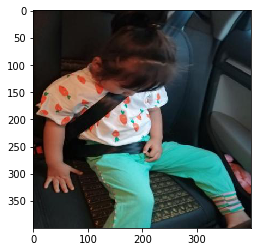

/home/ubuntu/db_proc/db/images/3_423.jpg


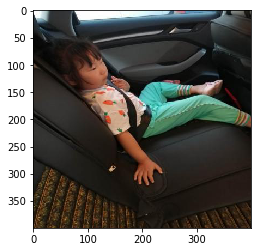

/home/ubuntu/db_proc/db/images/3_424.jpg


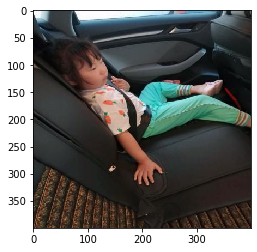

/home/ubuntu/db_proc/db/images/3_425.jpg


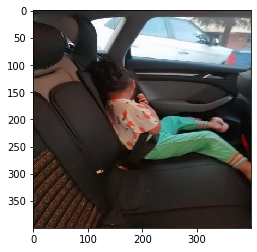

/home/ubuntu/db_proc/db/images/3_431.jpg


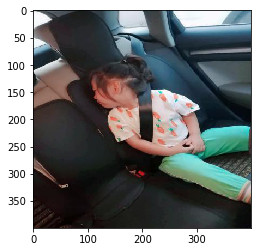

/home/ubuntu/db_proc/db/images/3_432.jpg


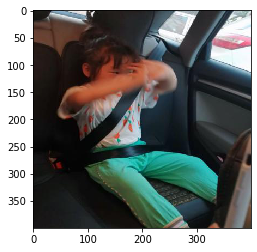

/home/ubuntu/db_proc/db/images/3_435.jpg


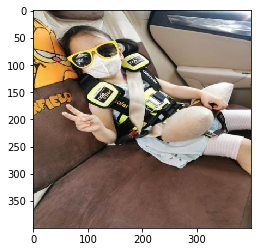

/home/ubuntu/db_proc/db/images/3_436.jpg


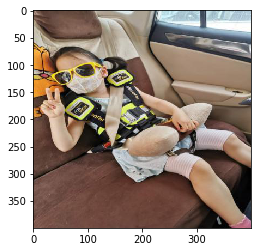

/home/ubuntu/db_proc/db/images/3_437.jpg


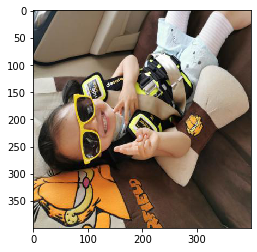

/home/ubuntu/db_proc/db/images/3_446.jpg


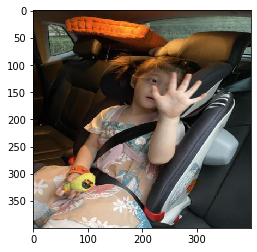

/home/ubuntu/db_proc/db/images/3_455.jpg


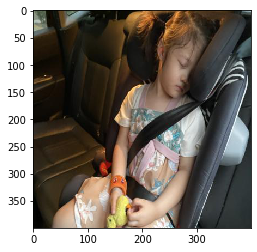

/home/ubuntu/db_proc/db/images/3_464.jpg


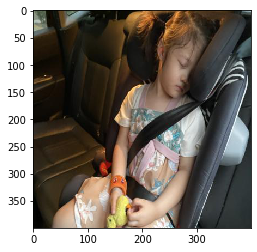

/home/ubuntu/db_proc/db/images/3_466.jpg


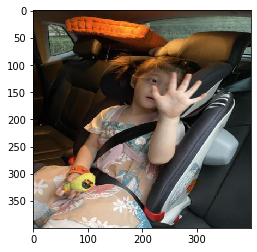

/home/ubuntu/db_proc/db/images/3_468.jpg


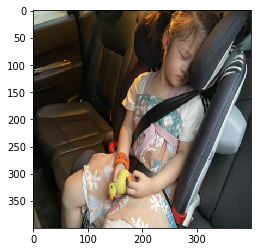

/home/ubuntu/db_proc/db/images/3_478.jpg


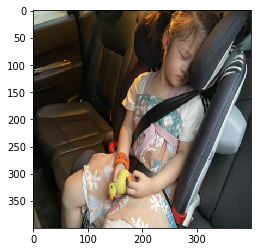

/home/ubuntu/db_proc/db/images/3_480.jpg


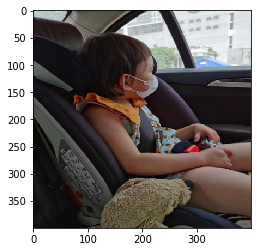

/home/ubuntu/db_proc/db/images/3_490.jpg


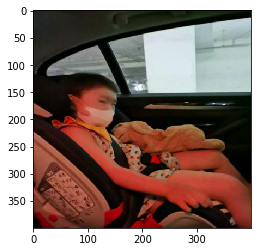

/home/ubuntu/db_proc/db/images/3_491.jpg


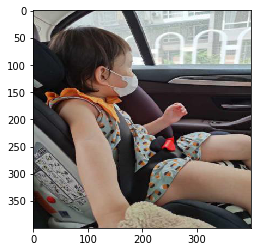

/home/ubuntu/db_proc/db/images/3_493.jpg


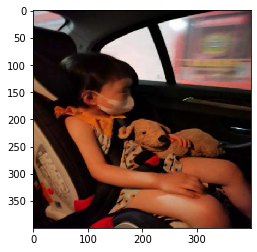

/home/ubuntu/db_proc/db/images/3_494.jpg


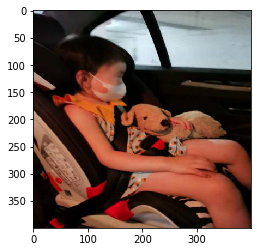

/home/ubuntu/db_proc/db/images/3_495.jpg


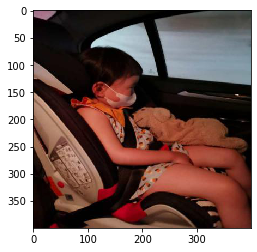

/home/ubuntu/db_proc/db/images/3_496.jpg


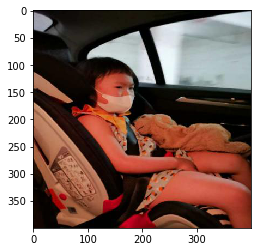

/home/ubuntu/db_proc/db/images/3_497.jpg


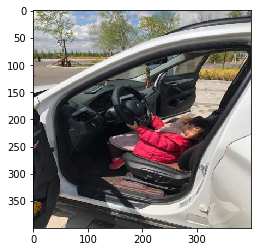

/home/ubuntu/db_proc/db/images/3_5.jpg


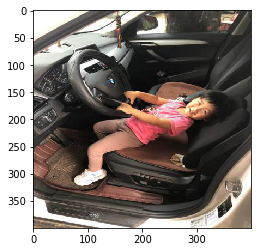

/home/ubuntu/db_proc/db/images/3_7.jpg


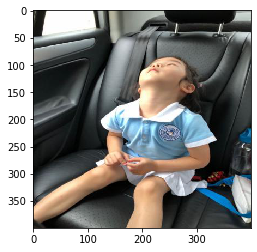

/home/ubuntu/db_proc/db/images/3_73.jpg


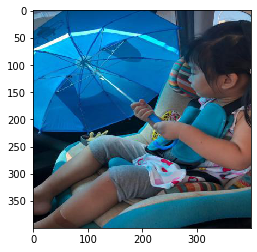

/home/ubuntu/db_proc/db/images/3_9.jpg


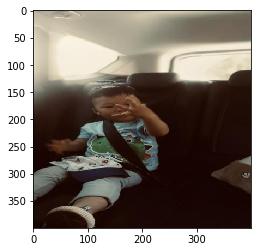

/home/ubuntu/db_proc/db/images/4_0.jpg


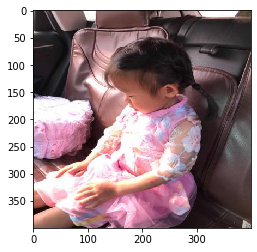

/home/ubuntu/db_proc/db/images/4_114.jpg


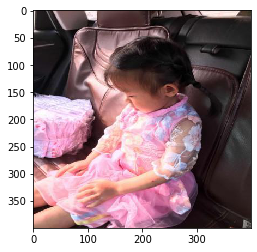

/home/ubuntu/db_proc/db/images/4_115.jpg


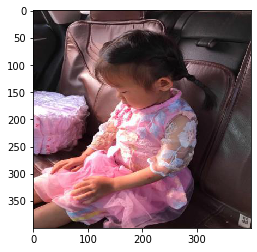

/home/ubuntu/db_proc/db/images/4_116.jpg


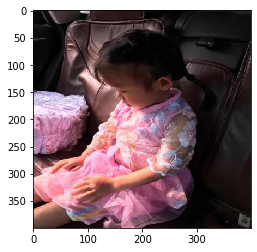

/home/ubuntu/db_proc/db/images/4_117.jpg


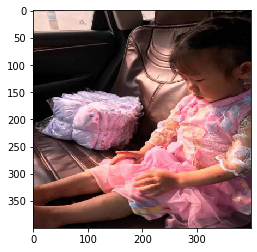

/home/ubuntu/db_proc/db/images/4_119.jpg


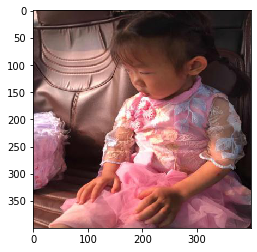

/home/ubuntu/db_proc/db/images/4_120.jpg


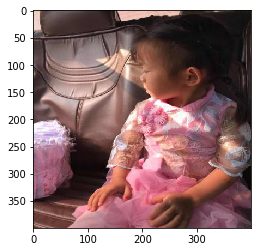

/home/ubuntu/db_proc/db/images/4_122.jpg


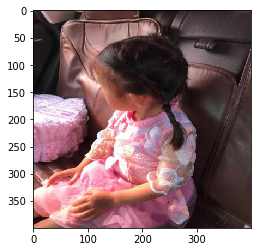

/home/ubuntu/db_proc/db/images/4_124.jpg


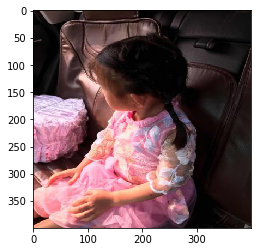

/home/ubuntu/db_proc/db/images/4_125.jpg


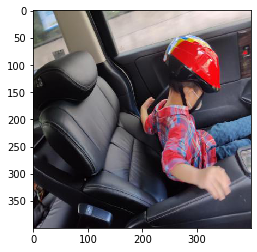

/home/ubuntu/db_proc/db/images/4_140.jpg


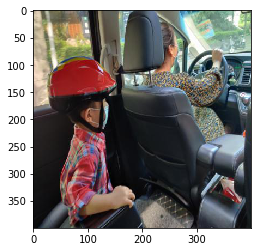

/home/ubuntu/db_proc/db/images/4_143.jpg


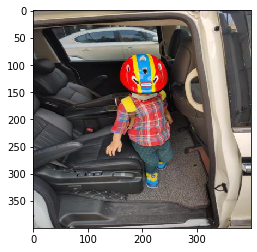

/home/ubuntu/db_proc/db/images/4_145.jpg


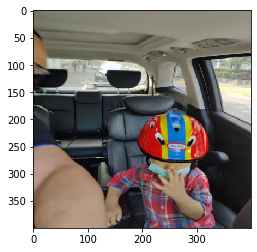

/home/ubuntu/db_proc/db/images/4_146.jpg


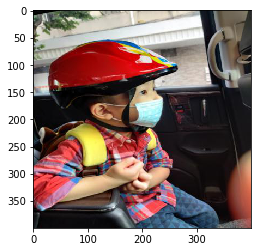

/home/ubuntu/db_proc/db/images/4_148.jpg


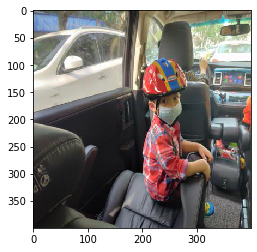

/home/ubuntu/db_proc/db/images/4_149.jpg


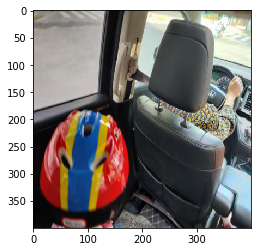

/home/ubuntu/db_proc/db/images/4_150.jpg


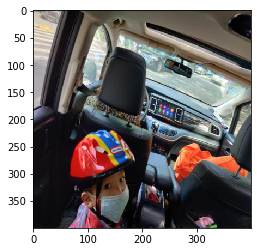

/home/ubuntu/db_proc/db/images/4_152.jpg


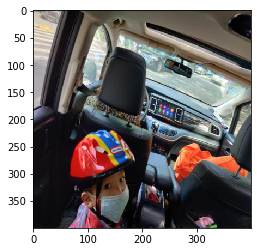

/home/ubuntu/db_proc/db/images/4_153.jpg


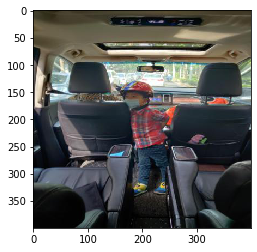

/home/ubuntu/db_proc/db/images/4_154.jpg


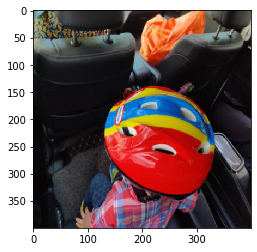

/home/ubuntu/db_proc/db/images/4_156.jpg


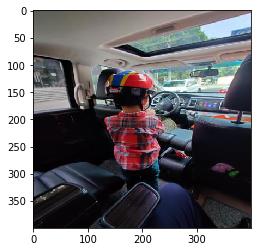

/home/ubuntu/db_proc/db/images/4_157.jpg


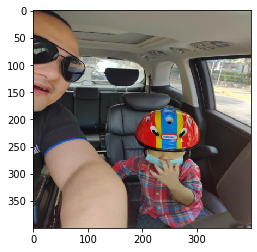

/home/ubuntu/db_proc/db/images/4_158.jpg


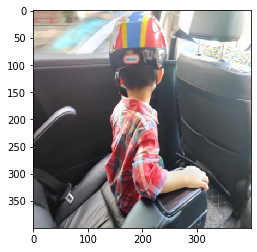

/home/ubuntu/db_proc/db/images/4_159.jpg


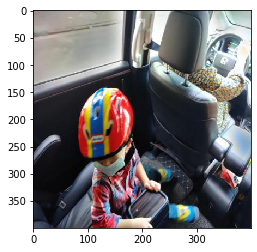

/home/ubuntu/db_proc/db/images/4_161.jpg


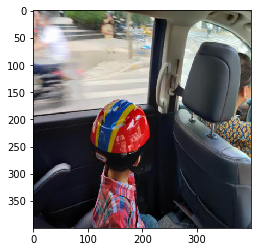

/home/ubuntu/db_proc/db/images/4_162.jpg


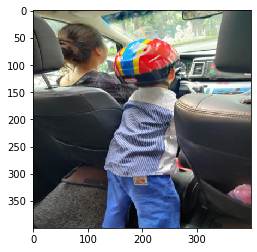

/home/ubuntu/db_proc/db/images/4_163.jpg


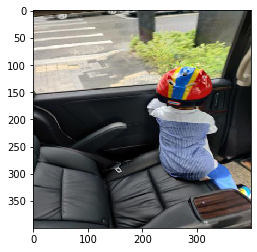

/home/ubuntu/db_proc/db/images/4_165.jpg


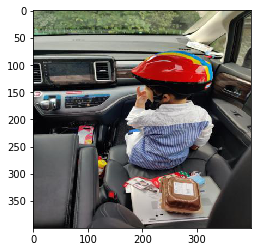

/home/ubuntu/db_proc/db/images/4_167.jpg


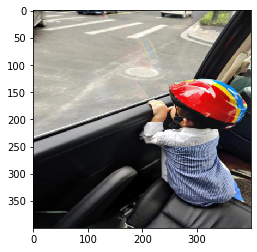

/home/ubuntu/db_proc/db/images/4_168.jpg


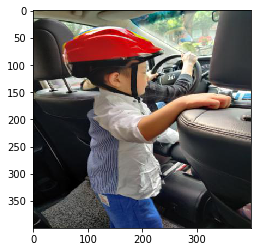

/home/ubuntu/db_proc/db/images/4_169.jpg


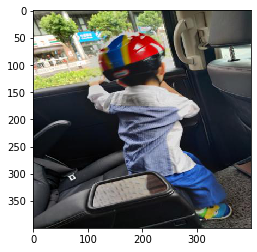

/home/ubuntu/db_proc/db/images/4_172.jpg


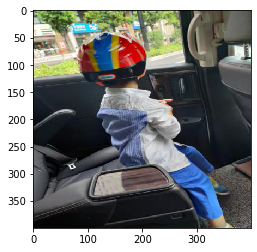

/home/ubuntu/db_proc/db/images/4_173.jpg


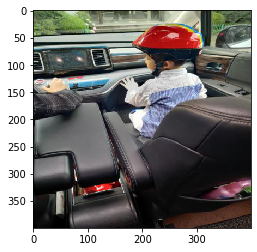

/home/ubuntu/db_proc/db/images/4_174.jpg


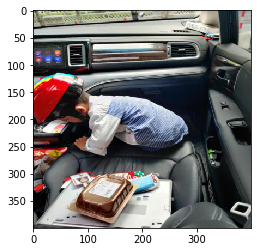

/home/ubuntu/db_proc/db/images/4_176.jpg


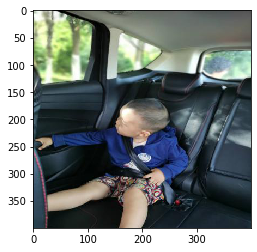

/home/ubuntu/db_proc/db/images/4_204.jpg


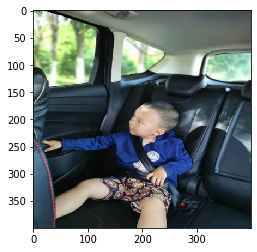

/home/ubuntu/db_proc/db/images/4_205.jpg


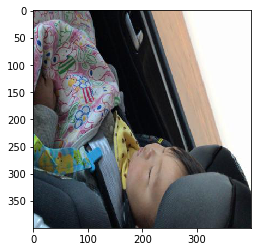

/home/ubuntu/db_proc/db/images/4_218.jpg


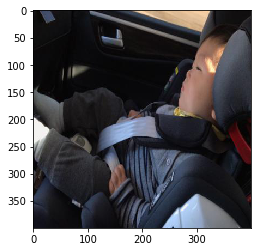

/home/ubuntu/db_proc/db/images/4_219.jpg


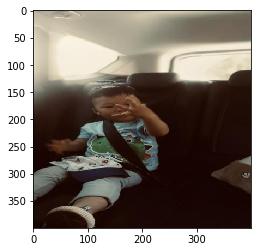

/home/ubuntu/db_proc/db/images/4_224.jpg


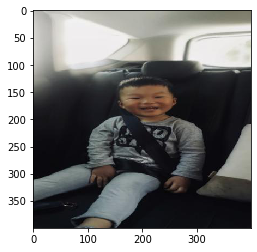

/home/ubuntu/db_proc/db/images/4_226.jpg


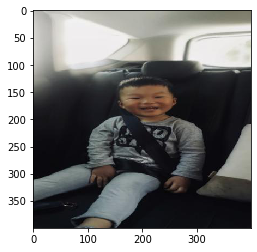

/home/ubuntu/db_proc/db/images/4_6.jpg


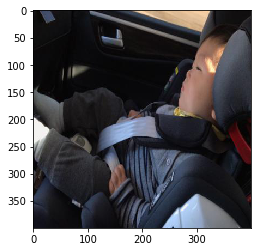

/home/ubuntu/db_proc/db/images/4_7.jpg


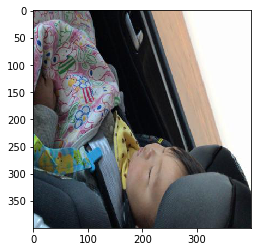

/home/ubuntu/db_proc/db/images/4_9.jpg


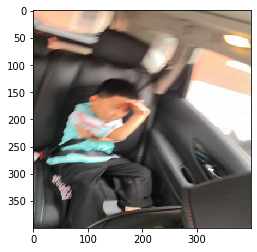

/home/ubuntu/db_proc/db/images/5_127.jpg


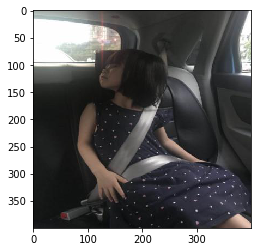

/home/ubuntu/db_proc/db/images/5_18.jpg


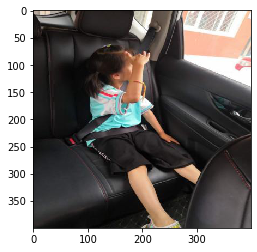

/home/ubuntu/db_proc/db/images/5_261.jpg


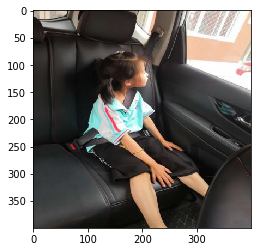

/home/ubuntu/db_proc/db/images/5_264.jpg


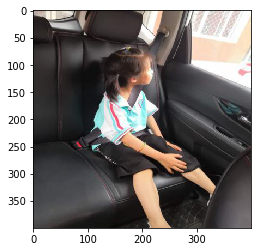

/home/ubuntu/db_proc/db/images/5_267.jpg


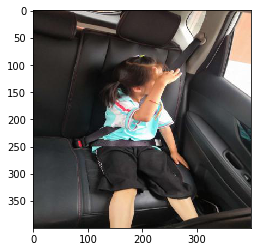

/home/ubuntu/db_proc/db/images/5_275.jpg


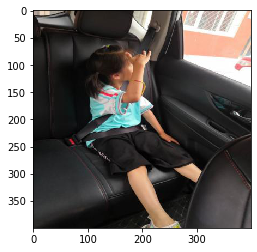

/home/ubuntu/db_proc/db/images/5_277.jpg


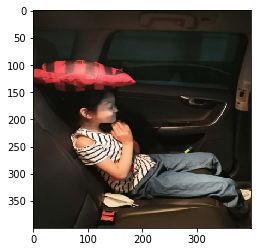

/home/ubuntu/db_proc/db/images/5_3.jpg


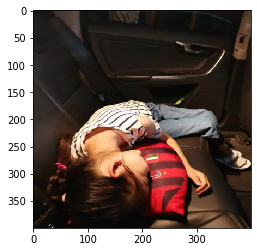

/home/ubuntu/db_proc/db/images/5_4.jpg


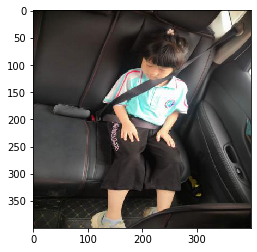

/home/ubuntu/db_proc/db/images/5_63.jpg


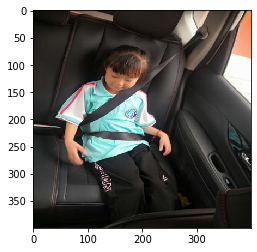

/home/ubuntu/db_proc/db/images/5_85.jpg


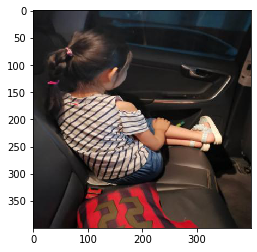

/home/ubuntu/db_proc/db/images/5_9.jpg


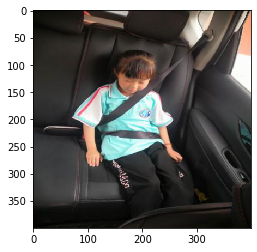

/home/ubuntu/db_proc/db/images/5_92.jpg


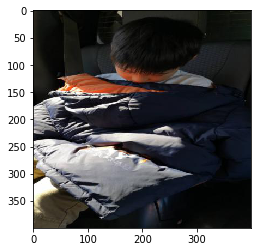

/home/ubuntu/db_proc/db/images/6_0.jpg


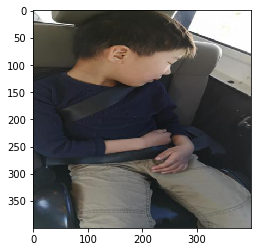

/home/ubuntu/db_proc/db/images/6_1.jpg


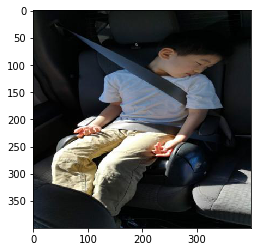

/home/ubuntu/db_proc/db/images/6_10.jpg


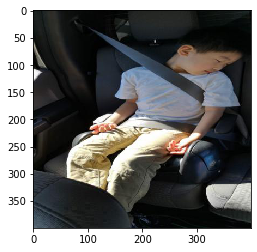

/home/ubuntu/db_proc/db/images/6_11.jpg


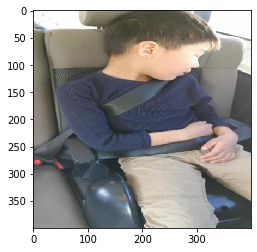

/home/ubuntu/db_proc/db/images/6_12.jpg


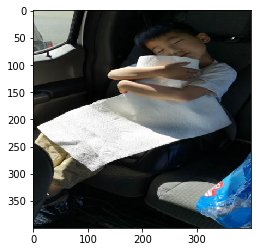

/home/ubuntu/db_proc/db/images/6_13.jpg


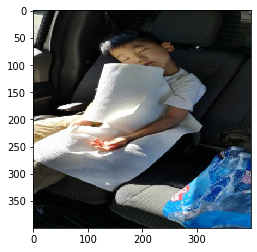

/home/ubuntu/db_proc/db/images/6_14.jpg


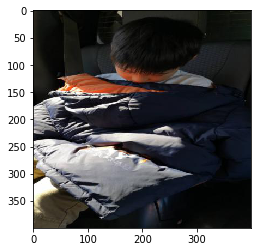

/home/ubuntu/db_proc/db/images/6_16.jpg


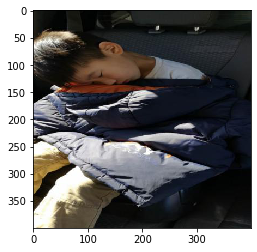

/home/ubuntu/db_proc/db/images/6_17.jpg


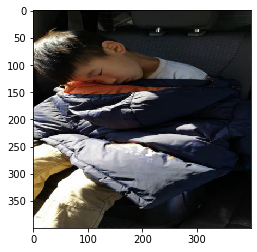

/home/ubuntu/db_proc/db/images/6_18.jpg


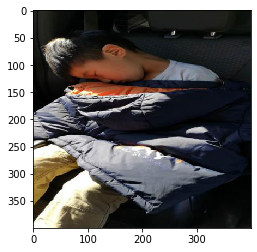

/home/ubuntu/db_proc/db/images/6_19.jpg


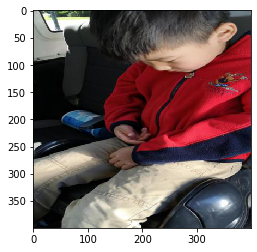

/home/ubuntu/db_proc/db/images/6_2.jpg


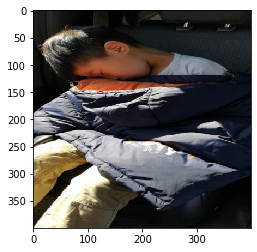

/home/ubuntu/db_proc/db/images/6_20.jpg


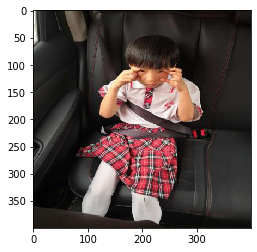

/home/ubuntu/db_proc/db/images/6_202.jpg


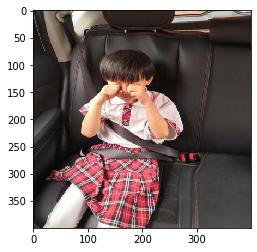

/home/ubuntu/db_proc/db/images/6_205.jpg


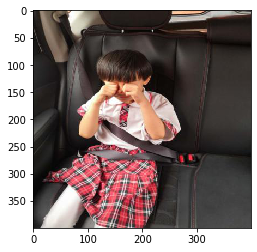

/home/ubuntu/db_proc/db/images/6_207.jpg


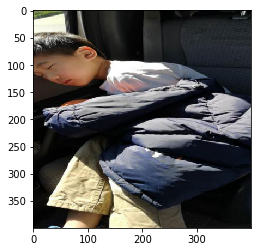

/home/ubuntu/db_proc/db/images/6_21.jpg


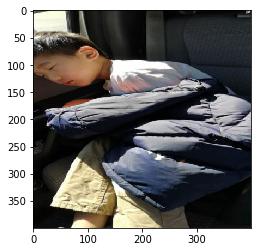

/home/ubuntu/db_proc/db/images/6_22.jpg


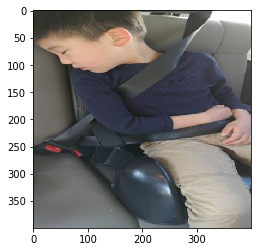

/home/ubuntu/db_proc/db/images/6_23.jpg


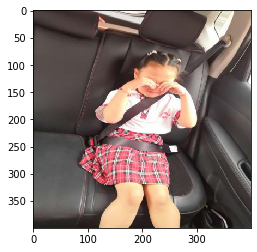

/home/ubuntu/db_proc/db/images/6_231.jpg


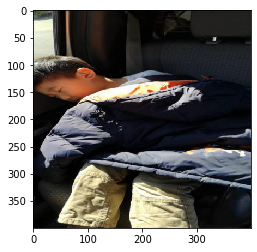

/home/ubuntu/db_proc/db/images/6_24.jpg


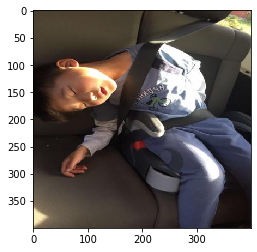

/home/ubuntu/db_proc/db/images/6_28.jpg


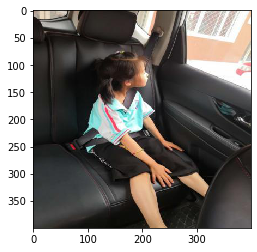

/home/ubuntu/db_proc/db/images/6_282.jpg


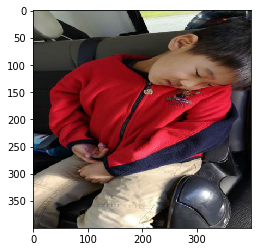

/home/ubuntu/db_proc/db/images/6_3.jpg


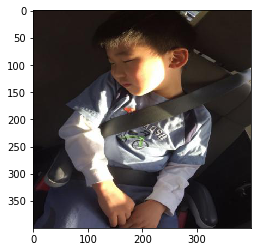

/home/ubuntu/db_proc/db/images/6_31.jpg


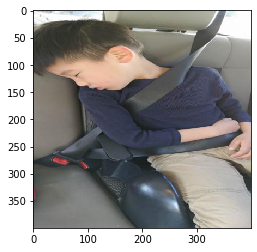

/home/ubuntu/db_proc/db/images/6_34.jpg


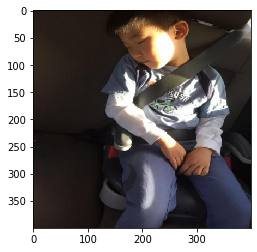

/home/ubuntu/db_proc/db/images/6_35.jpg


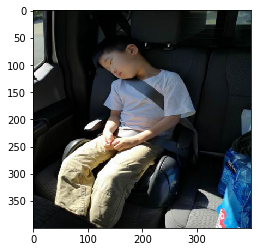

/home/ubuntu/db_proc/db/images/6_4.jpg


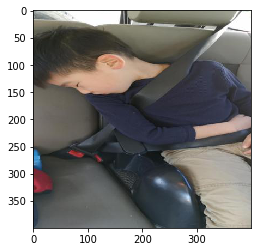

/home/ubuntu/db_proc/db/images/6_42.jpg


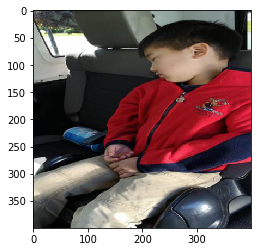

/home/ubuntu/db_proc/db/images/6_46.jpg


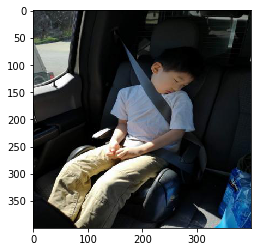

/home/ubuntu/db_proc/db/images/6_7.jpg


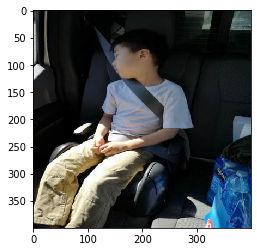

/home/ubuntu/db_proc/db/images/6_8.jpg


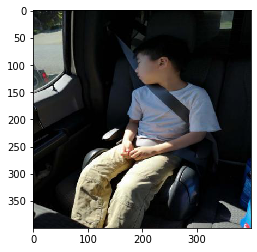

/home/ubuntu/db_proc/db/images/6_9.jpg


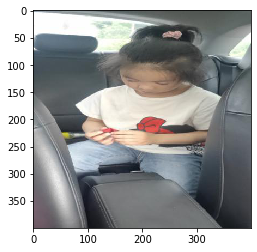

/home/ubuntu/db_proc/db/images/7_1.jpg
total: 1899; mtcnn fail count: 197


In [41]:
# pyplot, for debugging

# saving numpy data in files
# https://stackoverflow.com/questions/28439701/how-to-save-and-load-numpy-array-data-properly


import matplotlib.pyplot as plt

idx = 0
fail = 0
total = 0

for img in imgs:
    total += 1
    bbox, prob, landmarks = mtcnn(img, landmarks=True, eval_mode=True)
    
    if bbox is None:
        # mtcnn failed to detect a face
        fail += 1
        plt.imshow(imgs[idx]) # display failed image
        plt.show()
        print(img_files[idx])
        #bbox = np.zeros(4, dtype="int8") # set to int8, for indicating
        #prob = np.zeros(2, dtype="int8") # this image is not used
        #landmarks = np.zeros(10, dtype="int8")
    
    #prob = np.array([0, prob[0]])
    #np.save(fname[idx]+".bbox.npy", bbox)
    #np.save(fname[idx]+".prob.npy", prob)
    #np.save(fname[idx]+".landmarks.npy", landmarks)
    idx += 1

print("total: {}; mtcnn fail count: {}".format(total, fail))


In [ ]:
if bbox_train[4][0].dtype == np.dtype("float32"):
    print("yes")
else:
    print("no")


In [ ]:
print(prob[0])